# HUMAN PPI 


### PIPELINE OVERVIEW
+ graph with genes as nodes and edges
+ generate a matrix from nodes based on specific parameters (features, random walk, shortest path..)
+ multidimensional matrices > embedding with tsne into 2D or 3D 
----------
+ Visualization typologies:
+ 2D PORTRAIT
+ 3D PORTRAIT
+ 3D LANDSCAPE
+ 3D SPHERE
----------

In [35]:
from multidimvis_main import *

In [34]:
G = nx.read_edgelist('input/ppi_elist.txt',data=False)
# d_ent_sym, d_sym_ent = genent2sym()

d_gene_do = pickle.load( open( "input/d_gene_do.pkl", "rb" ) )
d_do_genes = pickle.load( open( "input/d_do_genes.pkl", "rb" ) )
d_do_names = pickle.load( open( "input/DO_names.pkl", "rb" ) )
d_names_do = {y:x for x,y in d_do_names.items()}

In [12]:
# CHOOSE DISEASE CATEGORY 
disease_category = 'cancer'

l_disease_genes = []
for d_name in d_names_do.keys():
    if d_name.find(disease_category) != -1:
        #print(d_name,d_names_do[d_name])
        try:
            l_genes = d_do_genes[d_names_do[d_name]]
            for gene in l_genes:
                l_disease_genes.append(gene)
        except:
            #print(d_names_do[d_name],d_name)
                pass
set_disease_genes = set(l_disease_genes)
print('\nThere are %s genes found to be associated with "%s".' %(len(set_disease_genes),disease_category))

sub_categories = {}
for d_name in d_names_do.keys():
    if d_name.find(disease_category) != -1:
        try:
            sub_categories[d_name,d_names_do[d_name]]=len(d_do_genes[d_names_do[d_name]])
            #print('specific disease: %s (%s) ; # associated genes: %s' %(d_name,d_names_do[d_name],len(d_do_genes[d_names_do[d_name]])))
        except:
            pass


There are 2499 genes found to be associated with "cancer".


### PPI - DISEASE SUBGRAPH 

In [5]:
'''

# SPECIFY SUB CATEGORY OF DISEASE

spec = 'DOID:5093'
# DOID:707 B-Cell Lymphoma (71 genes)
# DOID:9252 amino acids metabolic disorder (130 genes)
# DOID:14320 generalized anxiety disorder (112 genes)


spec_nodes = []
for k,v in d_do_genes.items():
    if spec == k:
        spec_nodes = v

set_spec_nodes = set(spec_nodes)


# SPECIFIED GRAPH 
G_sub = G_ppi.subgraph(set_spec_nodes)
G_sub_lcc = G_sub.subgraph(max(nx.connected_components(G_sub), key=len)) # largest connected component (lcc)
print('The lcc of the %s-sub PPI network contains %s genes.' %(disease_category,G_sub_lcc.number_of_nodes()))

G = G_sub_lcc

# Check which subcategory was chosen:
for k,v in sub_categories.items():
    if spec == k[1]:
        print(k,v)


G_sub = G_ppi.subgraph(set_disease_genes)
G = G_sub.subgraph(max(nx.connected_components(G_sub), key=len)) # largest connected component (lcc)

'''


There are 488 genes found to be associated with "sarcoma".
The lcc of the sarcoma-sub PPI network contains 438 genes.


### PPI RANDOM SUBGRAPH

In [35]:
'''PPI = nx.read_edgelist('input/ppi_elist.txt',data=False)
# d_ent_sym, d_sym_ent = genent2sym()

# RANDOM SAMPLE 

N = 1000
rand_set = rd.sample(PPI.nodes(), N)

PPI_sub = nx.subgraph(PPI, rand_set)
G = PPI_sub.subgraph(max(nx.connected_components(PPI_sub), key=len))  # extract lcc graph'''

# GRAPH PROPERTIES

In [36]:
degs = dict(G.degree())
#nodes = list(G.nodes())
#edges = list(G.edges())
#n_nodes = len(list(G.nodes()))
#nx.draw(G,pos=nx.spring_layout(G))
        
print('Number of nodes i.e. genes: %s' %len(list(G.nodes())))
print('Number of edges: %s' %len(list(G.edges())))
print('Network density: %.1f%%' %(200.*len(list(G.edges()))/(len(list(G.nodes()))*len(list(G.nodes()))-1)))

Number of nodes i.e. genes: 16376
Number of edges: 309355
Network density: 0.2%


#### Degree Distribution 

Degree min: 1
Degree max: 2123
Degree Mean: 37.78150952613581
Degree Variant: 5346.963375737941


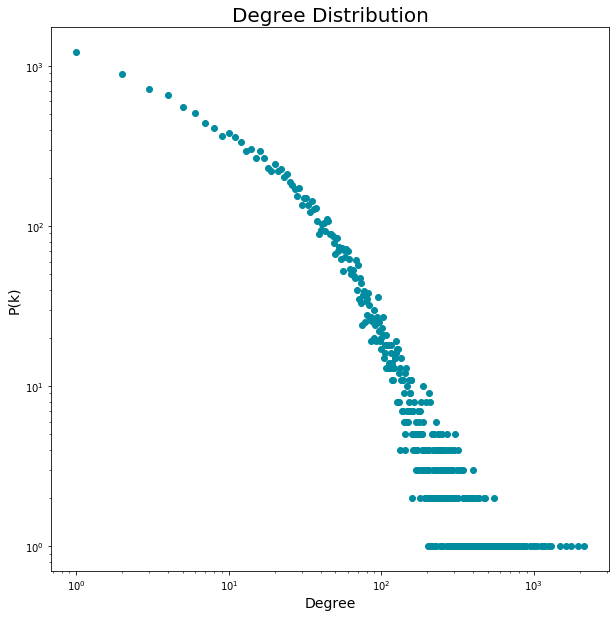

In [14]:
l_k = list(degs.values())
set_k = set(l_k)
print('Degree min:', min(l_k))
print('Degree max:', max(l_k))

d_k_f = {}
for k in set_k:
    d_k_f[k] = l_k.count(k)
#print('Degree counts:',d_k_f)

mean_deg = np.mean(l_k)
var_deg = np.var(l_k)
print('Degree Mean:', mean_deg)
print('Degree Variant:', var_deg)

plt.figure(figsize=(10,10))
plt.title('Degree Distribution', fontsize = 20)
plt.xlabel('Degree', fontsize = 14)
plt.ylabel('P(k)', fontsize = 14)
plt.loglog(list(d_k_f.keys()),list(d_k_f.values()),'o',c='#008CA0')
plt.show()

#plt.savefig('PPIdegreedist.png')

# FEATURE COLLECTION - Topological+Functional

#### + TOPOLOGICAL FEATURES
##### based on: https://networkx.github.io/documentation/stable/reference/algorithms/centrality.html
+ degree centrality
+ closeness centrality
+ betweeness centrality
+ eigenvector centrality

In [42]:
%%time 

# DEGREE CENTRALITY - Node degree: important nodes being involved within high number of interactions
degs = dict(G.degree())
d_deghubs = {}
for node, de in sorted(degs.items(),key = lambda x: x[1], reverse = 1):
    d_deghubs[node] = round(float(de/max(degs.values())),4)

CPU times: user 5.22 s, sys: 22.4 ms, total: 5.24 s
Wall time: 5.27 s


In [43]:
%%time 

# CLOSENESS CENTRALITY - Measures how closely a node is connected to all other nodes to highlight f.ex. core-periphery structure, or identify central nodes
closeness = nx.closeness_centrality(G)
d_clos = {}
for node, cl in sorted(closeness.items(), key = lambda x: x[1], reverse = 1):
    d_clos[node] = round(cl,4)

CPU times: user 1h 42min 44s, sys: 15.8 s, total: 1h 43min
Wall time: 1h 43min 18s


In [44]:
%%time 

# BETWEENESS CENTRALITY - How many shortest paths between pairs of other nodes in the network go through one node. High BC indicates "bottleneck nodes" in the network
betweens = nx.betweenness_centrality(G)
d_betw = {}
for node, be in sorted(betweens.items(), key = lambda x: x[1], reverse = 1):
     d_betw[node] = round(be,4)

CPU times: user 1h 35min 45s, sys: 9.56 s, total: 1h 35min 54s
Wall time: 1h 35min 58s


In [45]:
%%time 

# EIGENVECTOR CENTRALITY - Compute the eigenvector centrality for the graph
eigen = nx.eigenvector_centrality(G)
d_eigen = {}
for node, eig in sorted(eigen.items(), key = lambda x: x[1], reverse = 1):
     d_eigen[node] = round(eig,4)

CPU times: user 3.03 s, sys: 4.21 ms, total: 3.03 s
Wall time: 3.03 s


### Score System 

#### Disease Score ( Human PPI )  
+ additional parameter to emphasize disease (sub)category of nodes

In [5]:
def get_score_genes_disease(spec_doid):
    
    sub_cat_genes = {}
    for doid,genes in d_do_genes.items():
        if spec_doid == doid:
            sub_cat_genes[doid] = genes
            
    return sub_cat_genes.values()

In [6]:
def disease_subcategory_score(G, gene_list_with_highscore):

    # Assign score
    d_major_score = {}
    major_score = 1
    for nd in gene_list_with_highscore:
        for n in nd:
           # for node in G.nodes():
           #     if n == node:
            d_major_score[n] = major_score

    major_neigh = {}
    for n in d_major_score.keys():
        l = []
        for pair in G.edges():
            if n == pair[0]:
                l.append(pair[1])
                major_neigh[n] = l
            elif n == pair[1]:
                l.append(pair[0])
                major_neigh[n] = l

    minor_score = 0.9

    d_neigh_score = {}
    for node,score in d_major_score.items():
        for nd,neigh in major_neigh.items():
            for n in neigh:
                    if node==nd and n not in d_major_score.keys():
                        d_neigh_score[n] = minor_score

    d_all_scored = {**d_major_score,**d_neigh_score}

    d_no_score = {}
    for i in G.nodes():
        if i not in d_all_scored.keys():
            d_no_score[i] = 0

    d_score_nodes = {**d_no_score,**d_all_scored}
    
    return d_score_nodes

In [7]:
gene_list_retisarc = get_score_genes_disease('DOID:8538')  # 'reticulosarcoma', 'DOID:8538'): 24,
#gene_list_angiosarc = get_score_genes_disease('DOID:0001816') # 'angiosarcoma', 'DOID:0001816'): 18,
#gene_list_gliosarc = get_score_genes_disease('DOID:3071') #'gliosarcoma', 'DOID:3071'): 82

d_score_retisarc = disease_subcategory_score(G, gene_list_retisarc)
#d_score_angiosarc = disease_subcategory_score(G, gene_list_angiosarc)
#d_score_gliosarc = disease_subcategory_score(G, gene_list_gliosarc)

d_score_retisarc_sorted = {key:d_score_retisarc[key] for key in G.nodes()}

### Feature Collection

In [47]:
# same order of node IDs for all features

d_deghubs_sorted = {key:d_deghubs[key] for key in sorted(d_deghubs.keys())}
d_clos_sorted = {key:d_clos[key] for key in sorted(d_clos.keys())}
d_betw_sorted = {key:d_betw[key] for key in sorted(d_betw.keys())}
d_eigen_sorted = {key:d_eigen[key] for key in sorted(d_eigen.keys())}


# ------------------------------------------------------------------------------------------
# SCORES 
# ------------------------------------------------------------------------------------------

# Disease categories 
#d_score_bcell_sorted = {key:d_score_bcell[key] for key in sorted(d_score_bcell.keys())}
#d_score_metabol_sorted = {key:d_score_bcell[key] for key in sorted(d_score_bcell.keys())}
#d_score_anx_sorted = {key:d_score_bcell[key] for key in sorted(d_score_bcell.keys())}

# Disease subcategories 
#d_score_retisarc = {key:d_score_retisarc[key] for key in sorted(d_score_retisarc.keys())}
#d_score_angiosarc = {key:d_score_angiosarc[key] for key in sorted(d_score_angiosarc.keys())}
#d_score_gliosarc = {key:d_score_gliosarc[key] for key in sorted(d_score_gliosarc.keys())}


# feature collection
feature_dict = dict(zip(d_deghubs_sorted.keys(), zip(
                                                     d_deghubs_sorted.values(), 
                                                     d_clos_sorted.values(), 
                                                     d_betw_sorted.values(), 
                                                     d_eigen_sorted.values(),
    
                                                     #d_score_retisarc.values(),
                                                     #d_score_angiosarc.values(),
                                                     #d_score_gliosarc.values(),
    
                                                     #d_score_bcell.values(),
                                                     #d_score_metabol.values(),
                                                     #d_score_anx.values(),
    
                                                    )))

# IMPORTANT :
# sort all feature according to Graph node IDs
feature_dict_sorted = {key:feature_dict[key] for key in G.nodes()}
feature_df = pd.DataFrame.from_dict(feature_dict_sorted, orient = 'index', columns = ['degs', 
                                                                                      'clos', 
                                                                                      'betw', 
                                                                                      'eigen', 
                                                                                      
                                                                                      #'retisarc',
                                                                                      #'angiosarc',
                                                                                      #'gliosarc',
                                                                                      
                                                                                      #'bcell lymph',
                                                                                      #'metabolic',
                                                                                      #'anxiety',
                                                                                    
                                                                                      ]) 


l_features = [] 
for i in feature_dict_sorted.items():
    k = list(i)
    l_features.append(k)

In [48]:
feature_df.head()

,degs,clos,betw,eigen
66008,0.0170,0.3574,0.0001,0.0022
8473,0.0622,0.3899,0.0004,0.0111
2561,0.0033,0.3072,0.0000,0.0002
3759,0.0066,0.3173,0.0000,0.0004
22906,0.0080,0.3469,0.0000,0.0020


In [49]:
len(feature_df)

16376

### Matrix calculations (timed)

In [ ]:
%%time

A = nx.adjacency_matrix(G)
DM_adj = A.toarray()

In [ ]:
%%time

d_idx_entz = {}
cc = 0
for entz in sorted(G.nodes()):
    d_idx_entz[cc] = entz
    cc += 1

Mspl = np.zeros(len(list(G.nodes())))

for n1 in range(len(list(G.nodes()))):
    vec = []
    for n2 in range(len(list(G.nodes()))):
        geneA = d_idx_entz[n1]
        geneB = d_idx_entz[n2]
        try:
            spl = nx.shortest_path_length(G,geneA,geneB)
            vec.append(spl)
        except nx.NetworkXNoPath:
            print('no path')
        
    Mspl = np.vstack((Mspl,vec))
Mspl = np.delete(Mspl, (0), axis=0)

DM_spl = Mspl 

In [ ]:
%%time


# Restart probability
r = .8 # originally 0.8

alpha = 1.0 # indicating "randomness" 

DM_m = rnd_walk_matrix2(A, r, alpha, len(G.nodes()))
DM_m_mod = np.array([(1-(x/max(x))) for x in DM_m])

In [ ]:
%%time
min_log = lambda t: -np.log(t)
DM_mlog = np.array([min_log(x/max(x)) for x in DM_m])

In [ ]:
%%time
DM_cos = distance.squareform(distance.pdist(feature_df, 'cosine'))

In [ ]:
%%time
DM_eucl = distance.squareform(distance.pdist(feature_df, 'euclidean'))

In [ ]:
%%time
DM_sqeucl = distance.squareform(distance.pdist(feature_df, 'sqeuclidean'))

In [ ]:
%%time
DM_corr = distance.squareform(distance.pdist(feature_df, 'correlation'))

#### EXPORT MATRICES (dataframe) TO CSV

In [ ]:
organism = 'Human'

df_adj = pd.DataFrame(DM_adj, columns = list(G.nodes()), index=list(G.nodes()))
df_spl = pd.DataFrame(DM_spl, columns = list(G.nodes()), index=list(G.nodes()))
df_m = pd.DataFrame(DM_m_mod, columns = list(G.nodes()), index=list(G.nodes()))
df_mlog = pd.DataFrame(DM_mlog, columns = list(G.nodes()), index=list(G.nodes()))

df_cos = pd.DataFrame(DM_cos, columns = list(G.nodes()), index=list(G.nodes()))
df_eucl = pd.DataFrame(DM_eucl, columns = list(G.nodes()), index=list(G.nodes()))
df_sqeucl = pd.DataFrame(DM_sqeucl, columns = list(G.nodes()), index=list(G.nodes()))
df_corr = pd.DataFrame(DM_corr, columns = list(G.nodes()), index=list(G.nodes()))

# -----------------------------------------------


# Without Score
df_adj.to_csv(r'output_csv/Adjacency_Dataframe_'+organism+'.csv', index = True)
df_spl.to_csv(r'output_csv/SPL_Dataframe_'+organism+'.csv', index = True)
df_m.to_csv(r'output_csv/RWR_Dataframe_'+organism+'.csv', index = True)
df_mlog.to_csv(r'output_csv/RWRlog_Dataframe_'+organism+'.csv', index = True)

df_cos.to_csv(r'output_csv/PW_cos_Dataframe_'+organism+'.csv', index = True)
df_eucl.to_csv(r'output_csv/PW_eucl_Dataframe_'+organism+'.csv', index = True)
df_sqeucl.to_csv(r'output_csv/PW_sqeucl_Dataframe_'+organism+'.csv', index = True)
df_corr.to_csv(r'output_csv/PW_corr_Dataframe_'+organism+'.csv', index = True)

#### IMPORT MATRICES (dataframe) FROM CSV

In [15]:
# without Score

DM_adj = pd.read_csv('output_csv/Adjacency_Dataframe_Human.csv', index_col=0)
DM_spl = pd.read_csv('output_csv/SPL_Dataframe_Human.csv', index_col=0)
DM_m_mod = pd.read_csv('output_csv/RWR_Dataframe_Human.csv', index_col=0)
DM_mlog = pd.read_csv('output_csv/RWRlog_Dataframe_Human.csv', index_col=0)
DM_cos = pd.read_csv('output_csv/PW_cos_Dataframe_Human.csv', index_col=0)
DM_eucl = pd.read_csv('output_csv/PW_eucl_Dataframe_Human.csv', index_col=0)
DM_sqeucl = pd.read_csv('output_csv/Adjacency_Dataframe_Human.csv', index_col=0)
DM_corr = pd.read_csv('output_csv/Adjacency_Dataframe_Human.csv', index_col=0)

____________
# 2D

### 2D Visualization Settings
+ NODE SIZE + NODES/EDGES COLOURS (essentiality)

### COLOURING SUBCATEGORIES e.g. Disease subcategory (i.e. functional property)

In [ ]:
# input = dict

n = len(sub_categories)
colors = coloring_nodes(n)

doid_coloured = {}
c=0
for k,v in sub_categories.items():
    doid_coloured[k[1]]=colors[c]
    c+=1
    
d_gene_colours = {}
for doid, gene in d_do_genes.items(): 
    for i in gene:
        for do, col in doid_coloured.items():
            if doid == do:
                d_gene_colours[i]=col

# SORT dict based on G.nodes
d_gene_colours_sorted = {key:d_gene_colours[key] for key in G.nodes()}

l_col_subcat = list(d_gene_colours_sorted.values())


# NODE COLOURING based on Subcategory
colours = l_col_subcat 
edge_color = 'lightgrey'

#sns.palplot(colours)

### COLOURING CLOSENESS CENTRALITY (i.e. topological property)

In [ ]:
# Define colour parameter
d_to_be_coloured = d_clos # dict sorted by dict.values (that way the biggest value matches darkest colour of palette)


# Colouring
colour_groups = set(d_to_be_coloured.values())
colour_count = len(colour_groups)
palette = sns.color_palette('Reds', colour_count)

d_colourgroups = {}
for n in colour_groups:
    d_colourgroups[n] = [k for k in d_to_be_coloured.keys() if d_to_be_coloured[k] == n]
    
d_colourgroups_sorted = {key:d_colourgroups[key] for key in sorted(d_colourgroups.keys())}

d_val_col = {}
for idx,val in enumerate(d_colourgroups_sorted):
    for ix,v in enumerate(palette):
        if idx == ix:
            d_val_col[val] = v
d_node_colour = {}
for y in d_to_be_coloured.items(): # y[0] = node id, y[1] = val
    for x in d_val_col.items(): # x[0] = val, x[1] = (col,col,col)
        if x[0] == y[1]:
            d_node_colour[y[0]]=x[1]
            
# SORT dict based on G.nodes
d_node_colour_sorted = dict([(key, d_node_colour[key]) for key in G.nodes()])

l_col_clos = list(d_node_colour_sorted.values())

# NODE COLOURING based on Closeness Centrality
colours = l_col_clos 
edge_color = 'lightgrey'

#sns.palplot(colours)

### COLOURING DISEASE SCORES

In [ ]:
# TO DO : MAKE FUNCTION FOR COLORING 

gene_list = gene_list_retisarc



# COLOURS GENERATED / disease score and neighboring nodes

n = len(gene_list)
color_major = coloring_nodes(n)
 
factor = 1.7 # the higher the lighter
color_minor = []
for i in color_major:
    r,g,b = hex_to_rgb(i)
    color_light = adjust_color_lightness(r,g,b,factor)
    color_minor.append(color_light)
    
    
# ------------------------------------------------------
# NODES coloured 

# Major nodes coloured
d_col_major = {}
for n in d_major_score.keys():
    for i in color_major:
        d_col_major[n] = i

d_col_minor = {}
for node,col in d_col_major.items():
    for node in d_col_major.keys():
        for nd,neigh in major_neigh.items():
            for n in neigh:
                for i in color_minor:
                    if node==nd and n not in d_col_major.keys():
                        d_col_minor[n] = i
                    
d_col = {**d_col_major,**d_col_minor}

d_grey = {}
for i in G.nodes():
    if i not in d_col.keys():
        d_grey[i] = 'lightgrey'
        
        
d_col_all = {**d_col_major, **d_col_minor, **d_grey}
d_col_all_sorted = {key:d_col_all[key] for key in G.nodes()}

l_col_all = list(d_col_all_sorted.values())

colours = l_col_all

# ------------------------------------------------------
# EDGES coloured 

edge_lst = []
for edge in G.edges():
    for e in edge:
        for node in d_col_major.keys():
            if e == node:
                edge_lst.append(edge)
                
d_col_edges = {}
for e in edge_lst:
    for node,col in d_col_major.items():
        if e[0] == node:
            d_col_edges[e]=col
        elif e[1] == node:
            d_col_edges[e]=col

d_grey_edges = {}
for edge in G.edges():
    if edge not in d_col_edges.keys(): 
        d_grey_edges[edge] = 'lightgrey'
        
d_edges_all = {**d_col_edges, **d_grey_edges}

# Sort according to G.edges()
d_edges_all_sorted = {key:d_edges_all[key] for key in G.edges()}

edge_color = list(d_edges_all_sorted.values())

### COLOURING DISTINCTIVENESS CENTRALITY (i.e. topological property)

#### PERIPHERAL HUB considered nodes + adjacent nodes

In [237]:
'''from distinctiveness.dc import dc_all

distinct_central = dc_all(G, normalize = True, alpha = 1)
distinct_central = pd.DataFrame(distinct_central).sort_index()

d_distinctiveness = dict(distinct_central['D2']) # D2 for not considering arc weight

cutoff = 5 # select how many "important" nodes based on centrality to choose from

d_distinctiveness_cutoff = {}
for node, d in sorted(d_distinctiveness.items(), key = lambda x: x[1], reverse = 1)[:cutoff]:
    d_distinctiveness_cutoff[node] = d/max(d_distinctiveness.values())

# CREATE COLORS based on amount required
n = len(d_distinctiveness_cutoff)
color = coloring_nodes(n)

# LIGHTER COLORS for e.g. NEIGHBOURING NODES
factor = 1.7 # the higher the lighter
color_neigh = []
for i in color:
    r,g,b = hex_to_rgb(i)
    color_light = adjust_color_lightness(r,g,b,factor)
    color_neigh.append(color_light)


# ------------------------------------------------------
# DISTINCTIVENESS: NODES


# distinctiveness (peripheral hubs) coloured
d_col_distinct = {}
for idx,n in enumerate(d_distinctiveness_cutoff.keys()):
        d_col_distinct[n] = color[idx]
        
direct_neigh = {}
for n in d_col_distinct.keys():
    l = []
    for pair in G.edges():
        if n == pair[0]:
            l.append(pair[1])
            direct_neigh[n] = l
        elif n == pair[1]:
            l.append(pair[0])
            direct_neigh[n] = l

d_col_neigh = {}
for node,col in d_col_distinct.items():
    for idx, node in enumerate(d_col_distinct.keys()):
        for nd,neigh in direct_neigh.items():
            for n in neigh:
                if node==nd and n not in d_col_distinct.keys():
                    d_col_neigh[n]=color_neigh[idx]

d_col = {**d_col_distinct,**d_col_neigh}

# nodes with no connection to hub 
d_grey = {}
for i in G.nodes():
    if i not in d_col.keys():
        d_grey[i] = 'snow'

d_col_all = {**d_col_distinct, **d_col_neigh, **d_grey}
d_col_all_sorted = {key:d_col_all[key] for key in G.nodes()}

l_col_distinct = list(d_col_all_sorted.values())

colours = l_col_distinct # NODE COLOURING based on HUBS

# ------------------------------------------------------
# DISTINCTIVENESS: EDGES 

# Hub outgoing edges
edge_lst = []
for edge in G.edges():
    for e in edge:
        for node in d_col_distinct.keys():
            if e == node:
                edge_lst.append(edge)
                
# Color edges based on hubs
d_col_edges = {}
for e in edge_lst:
    for node,col in d_col_distinct.items():
        if e[0] == node:
            d_col_edges[e]=col
        elif e[1] == node:
            d_col_edges[e]=col

d_grey_edges = {}
for edge in G.edges():
    if edge not in d_col_edges.keys(): 
        d_grey_edges[edge] = 'silver'
        
d_edges_all = {**d_col_edges, **d_grey_edges}

# Sort according to G.edges()
d_edges_all_sorted = {key:d_edges_all[key] for key in G.edges()}

edge_color = list(d_edges_all_sorted.values())'''

Missing weights are automatically set equal to 1.
WARNING. Normalization of D3 is carried out using loose upper and lower bounds.


In [51]:
# choose radius parameter for layout

# dict param should be : {NODE ID: VALUE}
dict_param = d_score_retisarc_sorted

d_node_rad = assign_radius_to_nodes(G, dict_param)  

l_rad = list(set(d_node_rad.values()))
spheres_back = get_sphere_background(l_rad)

____________
# 2D

### GENERAL Visualization Settings
+ NODE SIZE + NODES/EDGES COLOURS (essentiality)

In [16]:
organism = 'human'

node_factor = 1.0
size = draw_node_degree(G, node_factor) # node size based on degree
#size = 15

opacity_nodes = 0.8
opacity_edges = 0.25

colours = 'red' # color_essentiality_nodes(G, essentials, nonessentials, ess_col, no_ess_col)
edge_color = 'lightgrey' #color_essentiality_edges(G, essentials, nonessentials, ess_col, no_ess_col)
node_edge_col = 'k'

### EMBEDDING 2D

In [17]:
prplxty = 50 # range: 5-50 / default = 30.
density = 1.  # default 12.
l_rate = 200 # default 200.
steps = 250 # min 250

In [18]:
%%time

embed_adj = embed_tsne_2D(DM_adj, prplxty, density, l_rate, steps)
posG_adj = get_posG(G,embed_adj)

CPU times: user 3min 31s, sys: 11.4 s, total: 3min 43s
Wall time: 1min 35s


In [19]:
%%time

embed_spl = embed_tsne_2D(DM_spl, prplxty, density, l_rate, steps)
posG_spl = get_posG(G,embed_spl)

CPU times: user 3min 37s, sys: 12.5 s, total: 3min 49s
Wall time: 1min 36s


In [20]:
%%time

embed_m = embed_tsne_2D(DM_m_mod, prplxty, density, l_rate, steps)
posG_m = get_posG(G,embed_m)

CPU times: user 3min 54s, sys: 13.9 s, total: 4min 8s
Wall time: 2min


In [21]:
%%time

embed_mlog = embed_tsne_2D(DM_mlog, prplxty, density, l_rate, steps)
posG_mlog =get_posG(G,embed_mlog)

CPU times: user 3min 18s, sys: 12.3 s, total: 3min 30s
Wall time: 1min 27s


In [26]:
%%time

embed_cos = embed_tsne_2D(DM_cos, prplxty, density, l_rate, steps)
posG_cos = get_posG(G,embed_cos)

ValueError: X should be a square distance matrix

In [23]:
%%time

embed_eucl = embed_tsne_2D(DM_eucl, prplxty, density, l_rate, steps)
posG_eucl = get_posG(G,embed_eucl)

ValueError: X should be a square distance matrix

In [24]:
%%time

embed_sqeucl = embed_tsne_2D(DM_sqeucl, prplxty, density, l_rate, steps)
posG_sqeucl = get_posG(G,embed_sqeucl)

CPU times: user 3min 29s, sys: 8.46 s, total: 3min 37s
Wall time: 1min 18s


In [25]:
%%time

embed_corr = embed_tsne_2D(DM_corr, prplxty, density, l_rate, steps)
posG_corr = get_posG(G,embed_corr)

KeyboardInterrupt: 

### 2D SPRING

In [ ]:
%%time

forceatlas2 = ForceAtlas2()
#posG_spring = forceatlas2.forceatlas2_networkx_layout(G, pos=None, iterations=200)
posG_spring = nx.spring_layout(G)

plt.figure(figsize=(18,18))
plt.title('Organic spring', size=16)
plt.xlabel('x - axis', fontsize=16)
plt.ylabel('y - axis', fontsize=16)

nx.draw_networkx_nodes(G, posG_spring,
                       edgecolors = 'k', 
                       linewidths = 0.5, 
                       node_color=colours, node_size=size)
nx.draw_networkx_edges(G, pos = posG_spring, width = 1., edge_color = edge_color, alpha = opacity_edges)
#nx.draw_networkx_labels(G, pos = posG_spring, font_size = fontsize_labels, font_color = 'black')

print('Network: ', organism)
print('Number of Nodes:', len(G.nodes()))

plt.savefig('output_plots/Organic_spring_layout2D_'+organism+'.png')
plt.show()

### 2D PORTRAITS

Network:  sarcoma
Number of nodes: 5785

Perplexity: 50
Early Exaggeration: 1.0
Learning rate: 200
Iterations: 250


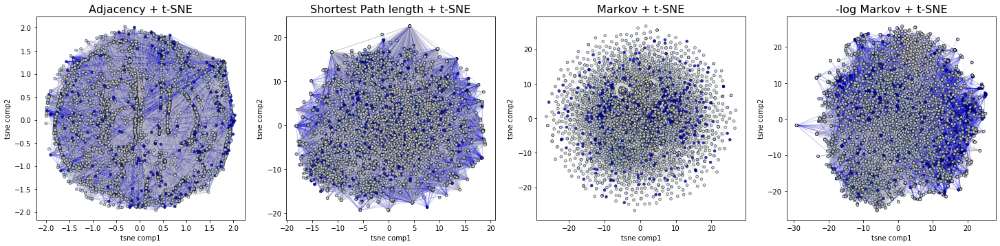

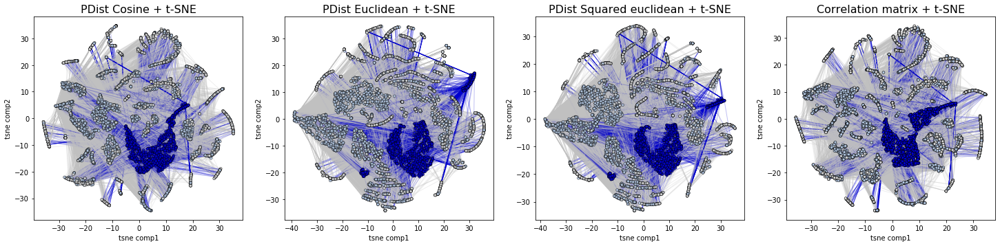

In [70]:
print('Network: ', organism)
print('Number of nodes:', len(G.nodes()))
print('')
print('Perplexity:', prplxty)
print('Early Exaggeration:', density)
print('Learning rate:', l_rate)
print('Iterations:', steps)


plt.figure(figsize=(25,25))

plt.subplot(441)
plt.title('Adjacency + t-SNE', size=16)
plt.xlabel('tsne comp1')
plt.ylabel('tsne comp2')

nx.draw_networkx_nodes(G, posG_adj, edgecolors = 'k', linewidths = 0.5, node_color=colours, node_size=size, alpha = opacity_nodes)
nx.draw_networkx_edges(G, pos = posG_adj, width = 1., edge_color = edge_color, alpha = opacity_edges)
#nx.draw_networkx_labels(G, pos = posG_adj, font_size = fontsize_labels, font_color = 'black')
plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)


plt.subplot(442)
plt.title('Shortest Path length + t-SNE', size=16)
plt.xlabel('tsne comp1')
plt.ylabel('tsne comp2')

nx.draw_networkx_nodes(G, posG_spl, edgecolors = 'k', linewidths = 0.5, node_color=colours, node_size=size, alpha = opacity_nodes)
nx.draw_networkx_edges(G, pos = posG_spl, width = 1., edge_color = edge_color, alpha = opacity_edges)
#nx.draw_networkx_labels(G, pos = posG_spl, font_size = fontsize_labels, font_color = 'black')
plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)


plt.subplot(443)
plt.title('Markov + t-SNE', size=16)
plt.xlabel('tsne comp1')
plt.ylabel('tsne comp2')
plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

nx.draw_networkx_nodes(G, posG_m, edgecolors = 'k', linewidths = 0.5, node_color=colours, node_size=size, alpha = opacity_nodes)
nx.draw_networkx_edges(G, pos = posG_m, width = 1., edge_color = 'lightgrey', alpha = opacity_edges)
#nx.draw_networkx_labels(G, pos = posG_m, font_size = fontsize_labels, font_color = 'black')
plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

plt.subplot(444)
plt.title('-log Markov + t-SNE', size=16)
plt.xlabel('tsne comp1')
plt.ylabel('tsne comp2')

nx.draw_networkx_nodes(G, posG_mlog, edgecolors = 'k', linewidths = 0.5, node_color=colours, node_size=size, alpha = opacity_nodes)
nx.draw_networkx_edges(G, pos = posG_mlog, width = 1., edge_color = edge_color, alpha = opacity_edges)
#nx.draw_networkx_labels(G, pos = posG_mlog, font_size = fontsize_labels, font_color = 'black')
plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

plt.savefig('output_plots/matrices_4x4_01'+ organism +'.png')
plt.show()


# 4 Plots
plt.figure(figsize=(25,25))

plt.subplot(441)
plt.xlabel('tsne comp1')
plt.ylabel('tsne comp2')
plt.title('PDist Cosine + t-SNE', size=16)

nx.draw_networkx_nodes(G, posG_cos, edgecolors = 'k', linewidths = 0.5, node_color=colours, node_size=size, alpha = opacity_nodes)
nx.draw_networkx_edges(G, pos = posG_cos, width = 1., edge_color = edge_color, alpha = opacity_edges)
#nx.draw_networkx_labels(G, pos = posG_cos, font_size = fontsize_labels, font_color = 'black')
plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)


plt.subplot(442)
plt.xlabel('tsne comp1')
plt.ylabel('tsne comp2')
plt.title('PDist Euclidean + t-SNE', size=16)

nx.draw_networkx_nodes(G, posG_eucl, edgecolors = 'k', linewidths = 0.5, node_color=colours, node_size=size, alpha = opacity_nodes)
nx.draw_networkx_edges(G, pos = posG_eucl, width = 1., edge_color = edge_color, alpha = opacity_edges)
#nx.draw_networkx_labels(G, pos = posG_eucl, font_size = fontsize_labels, font_color = 'black')
plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)


plt.subplot(443)
plt.xlabel('tsne comp1')
plt.ylabel('tsne comp2')
plt.title('PDist Squared euclidean + t-SNE', size=16)

nx.draw_networkx_nodes(G, posG_sqeucl, edgecolors = 'k', linewidths = 0.5, node_color=colours, node_size=size, alpha = opacity_nodes)
nx.draw_networkx_edges(G, pos = posG_sqeucl, width = 1., edge_color = edge_color, alpha = opacity_edges)
#nx.draw_networkx_labels(G, pos = posG_sqeucl, font_size = fontsize_labels, font_color = 'black')
plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)


plt.subplot(444)
plt.xlabel('tsne comp1')
plt.ylabel('tsne comp2')
plt.title('Correlation matrix + t-SNE', size=16)

nx.draw_networkx_nodes(G, posG_corr, edgecolors = 'k', linewidths = 0.5, node_color=colours, node_size=size)#, alpha = opacity_nodes)
nx.draw_networkx_edges(G, pos = posG_corr, width = 1., edge_color = edge_color, alpha = opacity_edges)
#nx.draw_networkx_labels(G, pos = posG_corr, font_size = fontsize_labels, font_color = 'black')
plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

plt.savefig('output_plots/matrices_4x4_2'+ organism +'.png')
plt.show()

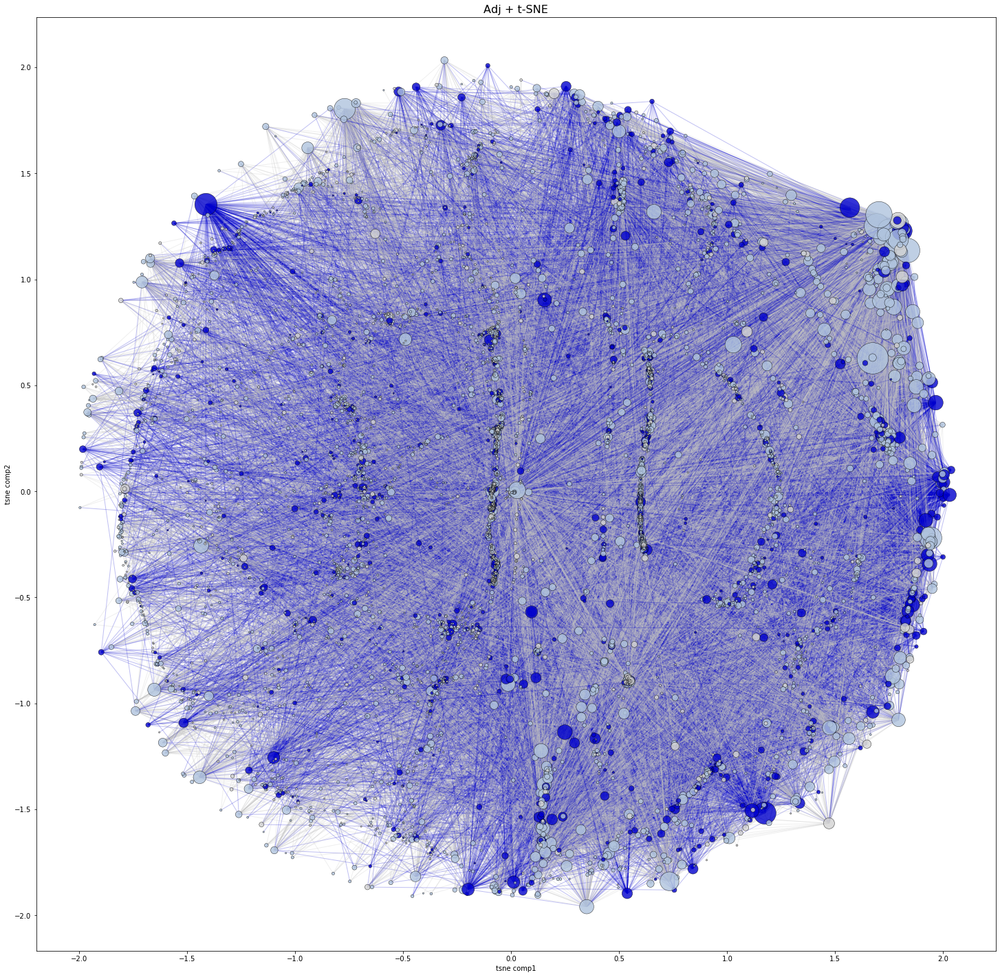

In [71]:
node_factor = 2.5
size = draw_node_degree(G, node_factor) # node size based on degree

plt.figure(figsize=(25,25))
plt.xlabel('tsne comp1')
plt.ylabel('tsne comp2')
plt.title('Adj + t-SNE', size=16)

nx.draw_networkx_nodes(G, posG_adj, edgecolors = 'k', linewidths = 0.5, node_color=colours, node_size=size, alpha = opacity_nodes)
nx.draw_networkx_edges(G, pos = posG_adj, width = 1., edge_color = edge_color, alpha = opacity_edges)
#nx.draw_networkx_labels(G, pos = posG_adj, font_size = fontsize_labels, font_color = 'black')

plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

plt.savefig('output_plots/2D_adj_'+organism+'.png')

plt.show()

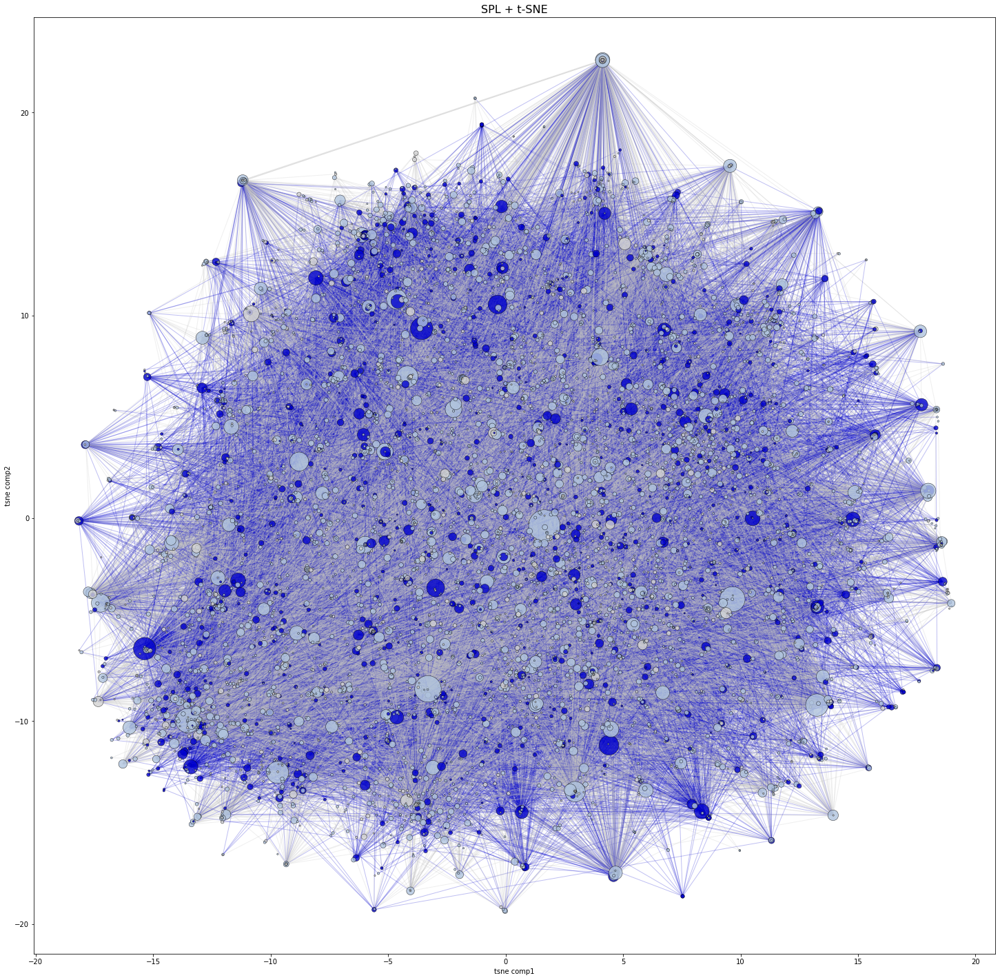

In [72]:
node_factor = 2.5
size = draw_node_degree(G, node_factor) # node size based on degree

plt.figure(figsize=(25,25))
plt.xlabel('tsne comp1')
plt.ylabel('tsne comp2')
plt.title('SPL + t-SNE', size=16)

nx.draw_networkx_nodes(G, posG_spl, edgecolors = 'k', linewidths = 0.5, node_color=colours, node_size=size, alpha = opacity_nodes)
nx.draw_networkx_edges(G, pos = posG_spl, width = 1., edge_color = edge_color, alpha = opacity_edges)
#nx.draw_networkx_labels(G, pos = posG_spl, font_size = fontsize_labels, font_color = 'black')

plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

plt.savefig('output_plots/2D_spl_'+organism+'.png')

plt.show()

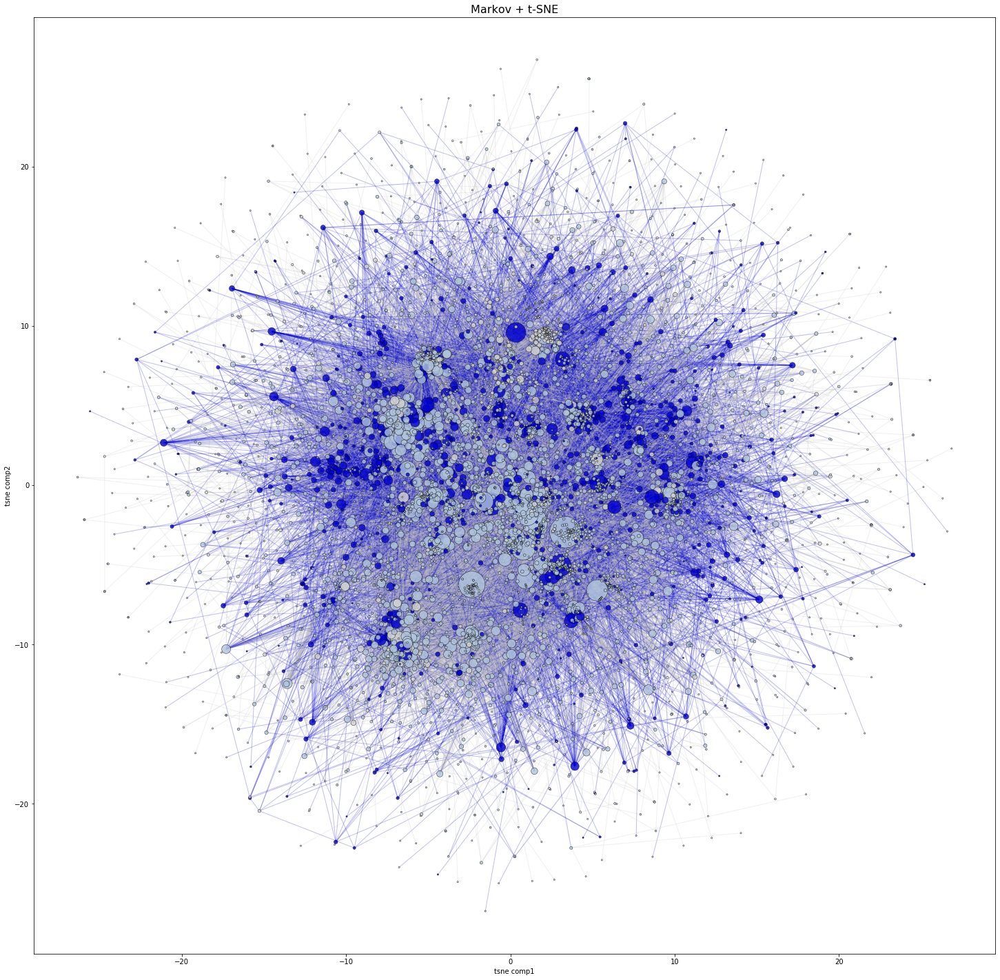

In [73]:
#node_factor = 1.0
#size = draw_node_degree(G, node_factor) # node size based on degree

plt.figure(figsize=(25,25))
plt.xlabel('tsne comp1')
plt.ylabel('tsne comp2')
plt.title('Markov + t-SNE', size=16)

nx.draw_networkx_nodes(G, posG_m, edgecolors = 'k', linewidths = 0.5, node_color=colours, node_size=size, alpha = opacity_nodes)
nx.draw_networkx_edges(G, pos = posG_m, width = 1., edge_color = edge_color, alpha = opacity_edges)
#nx.draw_networkx_labels(G, pos = posG_eucl, font_size = fontsize_labels, font_color = 'black')
plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

plt.savefig('output_plots/2D_markov_'+organism+'.png')

plt.show()

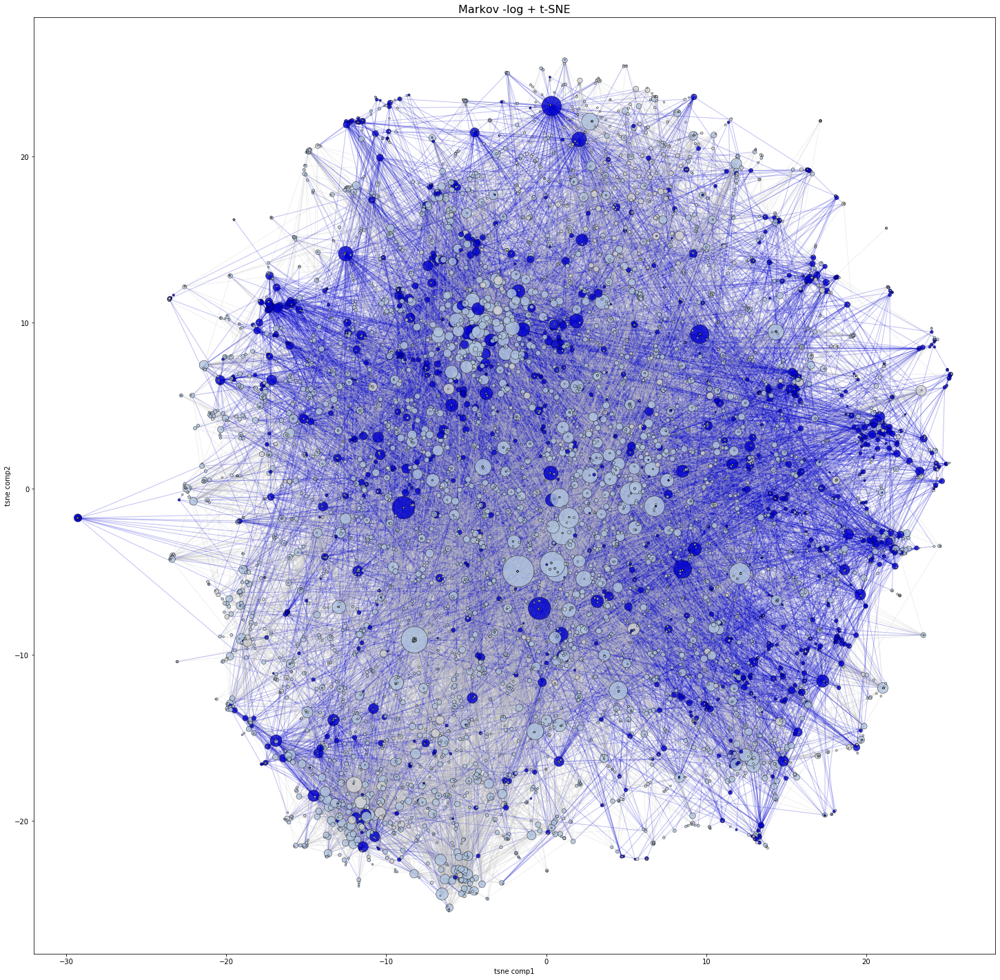

In [74]:
#node_factor = 1.0
#size = draw_node_degree(G, node_factor) # node size based on degree

plt.figure(figsize=(25,25))

plt.title('Markov -log + t-SNE', size=16)
plt.xlabel('tsne comp1')
plt.ylabel('tsne comp2')

nx.draw_networkx_nodes(G, posG_mlog, edgecolors = 'k', linewidths = 0.5, node_color=colours, node_size=size, alpha = opacity_nodes)
nx.draw_networkx_edges(G, pos = posG_mlog, width = 1., edge_color = edge_color, alpha = opacity_edges)
plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

plt.savefig('output_plots/2D_mlog_'+ organism +'.png')

plt.show()

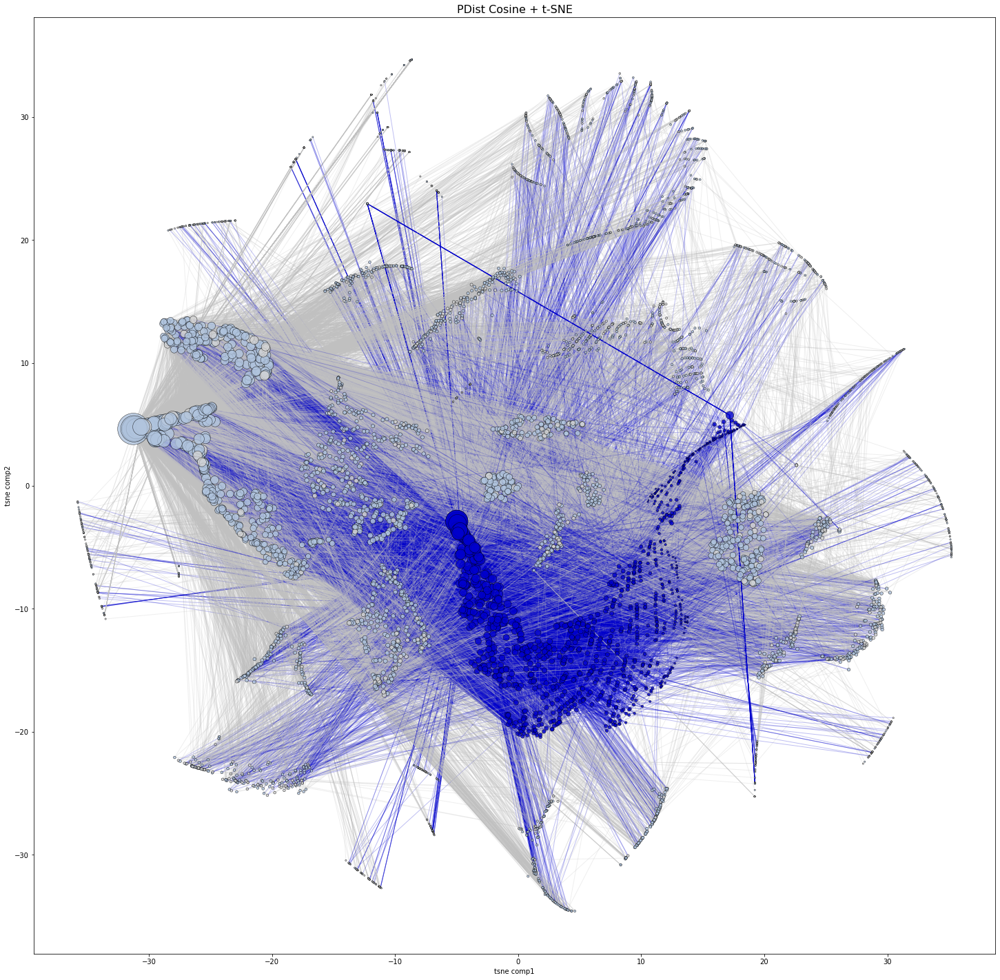

In [75]:
#node_factor = 1.0
#size = draw_node_degree(G, node_factor) # node size based on degree

plt.figure(figsize=(25,25))
plt.xlabel('tsne comp1')
plt.ylabel('tsne comp2')
plt.title('PDist Cosine + t-SNE', size=16)

nx.draw_networkx_nodes(G, posG_cos, edgecolors = 'k', linewidths = 0.5, node_color=colours, node_size=size, alpha = opacity_nodes)
nx.draw_networkx_edges(G, pos = posG_cos, width = 1., edge_color = edge_color, alpha = opacity_edges)
plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

plt.savefig('output_plots/2D_cos_'+organism+'.png')

plt.show()

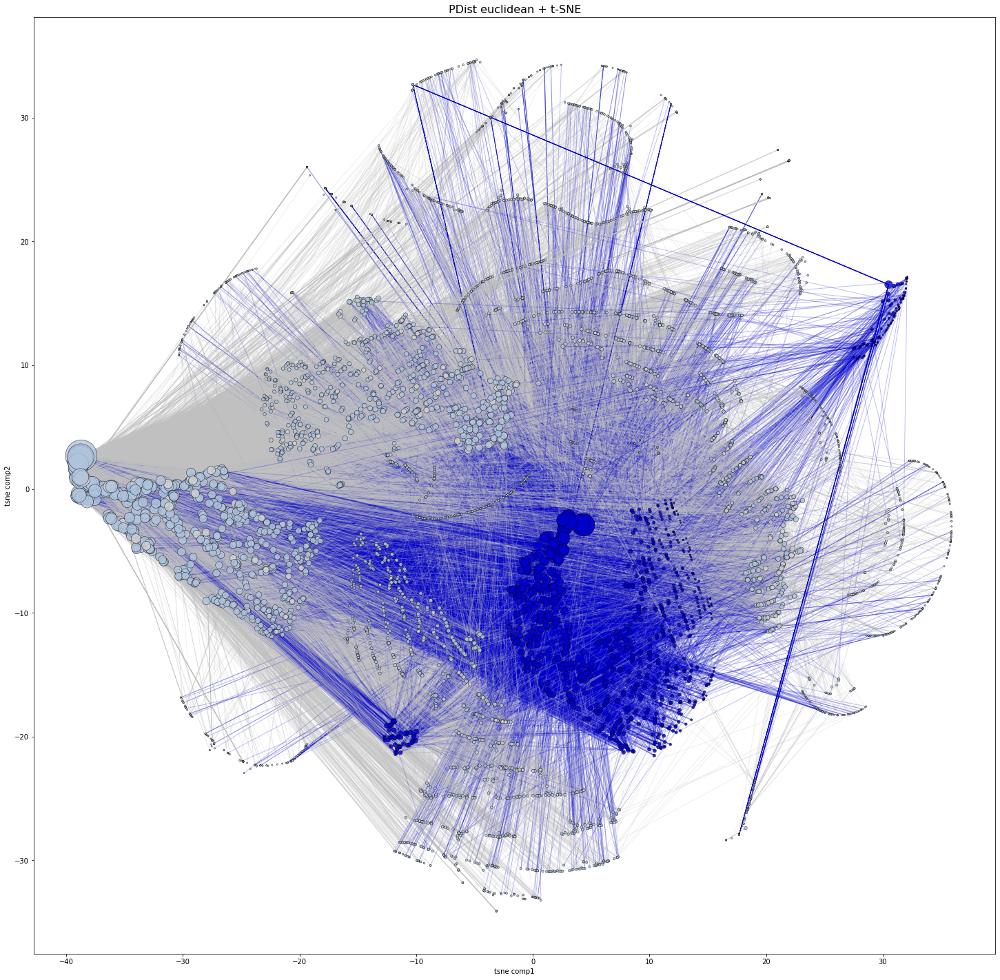

In [76]:
#node_factor = 1.0
#size = draw_node_degree(G, node_factor) # node size based on degree

plt.figure(figsize=(25,25))
plt.xlabel('tsne comp1')
plt.ylabel('tsne comp2')
plt.title('PDist euclidean + t-SNE', size=16)

nx.draw_networkx_nodes(G, posG_eucl, edgecolors = 'k', linewidths = 0.5, node_color=colours, node_size=size, alpha = opacity_nodes)
nx.draw_networkx_edges(G, pos = posG_eucl, width = 1., edge_color = edge_color, alpha = opacity_edges)
plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

plt.savefig('output_plots/2D_eucl_'+organism+'.png')

plt.show()

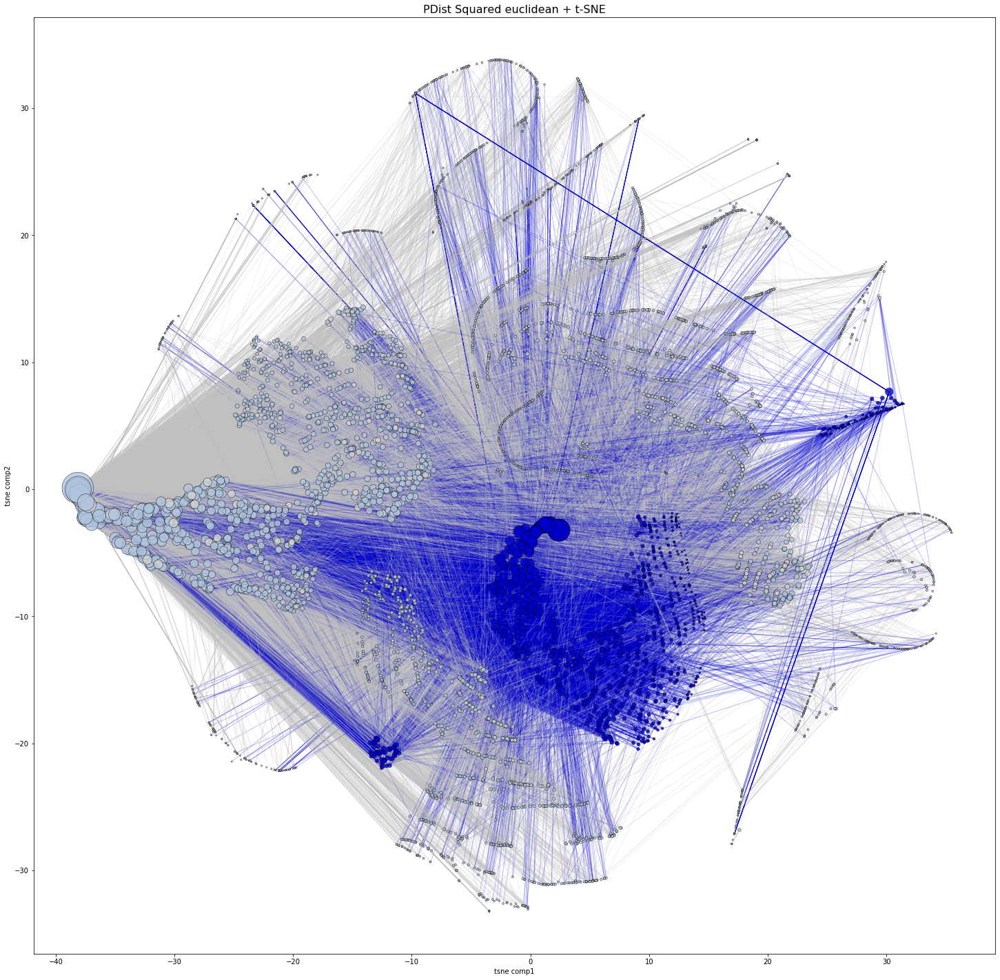

In [77]:
#node_factor = 1.0
#size = draw_node_degree(G, node_factor) # node size based on degree

plt.figure(figsize=(25,25))
plt.xlabel('tsne comp1')
plt.ylabel('tsne comp2')
plt.title('PDist Squared euclidean + t-SNE', size=16)

nx.draw_networkx_nodes(G, posG_sqeucl, edgecolors = 'k', linewidths = 0.5, node_color=colours, node_size=size, alpha = opacity_nodes)
nx.draw_networkx_edges(G, pos = posG_sqeucl, width = 1., edge_color = edge_color, alpha = opacity_edges)
plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

plt.savefig('output_plots/2D_sqeucl_'+organism+'.png')

plt.show()

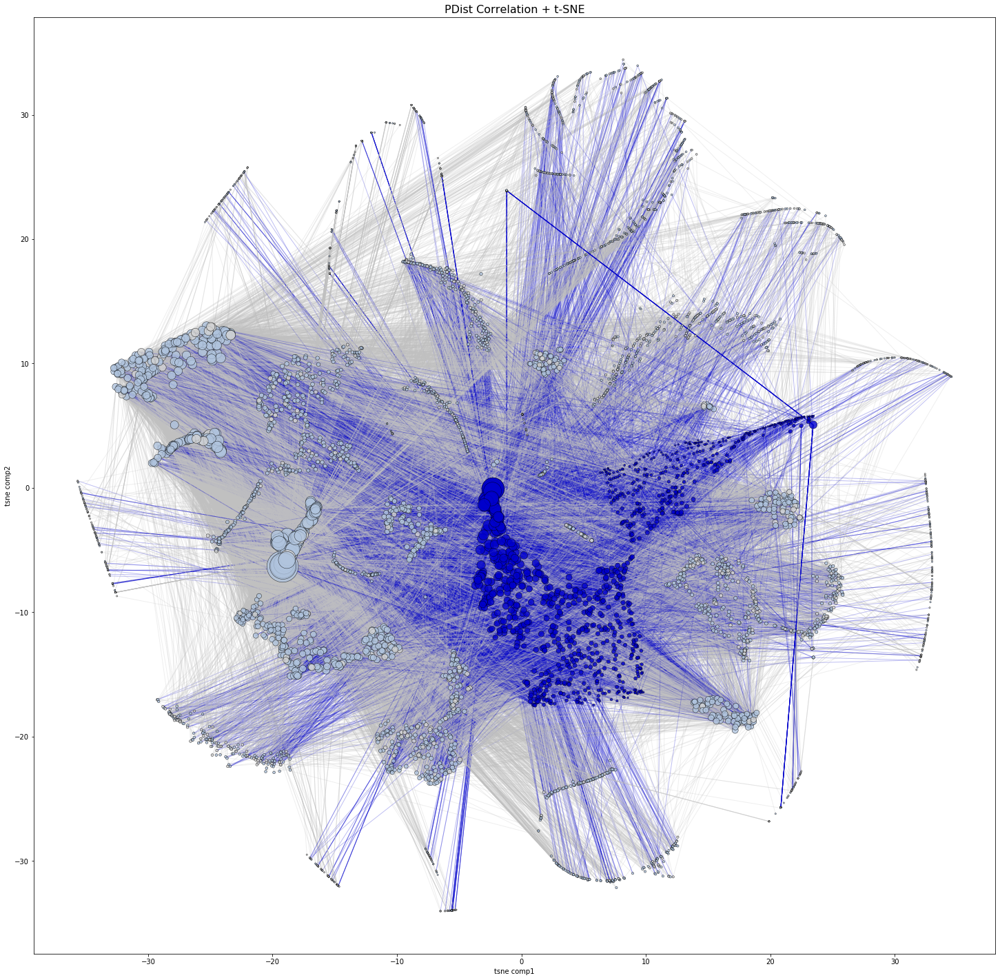

In [78]:
#node_factor = 1.0
#size = draw_node_degree(G, node_factor) # node size based on degree

plt.figure(figsize=(25,25))
plt.xlabel('tsne comp1')
plt.ylabel('tsne comp2')
plt.title('PDist Correlation + t-SNE', size=16)

nx.draw_networkx_nodes(G, posG_corr, edgecolors = 'k', linewidths = 0.5, node_color=colours, node_size=size, alpha = opacity_nodes)
nx.draw_networkx_edges(G, pos = posG_corr, width = 1., edge_color = edge_color, alpha = opacity_edges)
plt.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

plt.savefig('output_plots/2D_corr_'+organism+'.png')

plt.show()

____________
# 3D

### 3D Visualization Settings

In [ ]:
%%time 

#node_factor = 15
#size3d = draw_node_degree_3D(G, node_factor) # node size based on degree 
# for 3D best values are between 1-15

size3d = 3

In [92]:
edge_color_3d = []
for i in edge_color:
    edge_color_3d.append(i)
    edge_color_3d.append(i)
    edge_color_3d.append(0)
    
edge_color = edge_color_3d

### EMBEDDING 3D PORTRAITS

In [ ]:
prplxty3d = 50 # range: 5-50 / default = 30.#
density3d = 1.2 # default 12.
l_rate3d = 1000 # default 200.
steps3d = 250 #min 250

l_features = None 

In [ ]:
%%time
posG3d_adj = embed_tsne_3D(G, DM_adj, prplxty3d, density3d, l_rate3d, steps3d)

In [ ]:
%%time
posG3d_spl = embed_tsne_3D(G, DM_spl, prplxty3d, density3d, l_rate3d, steps3d)

In [ ]:
%%time
posG3d_m = embed_tsne_3D(G, DM_m_mod, prplxty3d, density3d, l_rate3d, steps3d)

In [ ]:
%%time
posG3d_mlog = embed_tsne_3D(G, DM_mlog, prplxty3d, density3d, l_rate3d, steps3d)

In [ ]:
%%time
posG3d_cos = embed_tsne_3D(G, DM_cos, prplxty3d, density3d, l_rate3d, steps3d)

In [ ]:
%%time
posG3d_eucl = embed_tsne_3D(G, DM_eucl, prplxty3d, density3d, l_rate3d, steps3d)

In [ ]:
%%time
posG3d_sqeucl = embed_tsne_3D(G, DM_sqeucl, prplxty3d, density3d, l_rate3d, steps3d)

In [ ]:
%%time
posG3d_corr = embed_tsne_3D(G, DM_corr, prplxty3d, density3d, l_rate3d, steps3d)

### 3D Portraits | EXPORT Coordinates x,y,z,rgba

In [ ]:
'''
organism = 'Human'


colours_rgba = []
for i in colours: 
    if i == ess_col:
        colours_rgba.append('rgba(5, 42, 128, 0.6)')
    elif i == no_ess_col:
        colours_rgba.append('rgba(93, 140, 248, 0.6)')
    else:
        colours_rgba.append('rgba(0,0,0,0.4)')
        
        
df_xyz_rgba_3Dspring = pd.DataFrame(posG3d_spring, index=["x","y","z"]).T
df_xyz_rgba_3Dspring['color'] = colours_rgba

df_xyz_rgba_3Dadj = pd.DataFrame(posG3d_adj, index=["x","y","z"]).T
df_xyz_rgba_3Dadj['color'] = colours_rgba

df_xyz_rgba_3Dspl = pd.DataFrame(posG3d_spl, index=["x","y","z"]).T
df_xyz_rgba_3Dspl['color'] = colours_rgba

df_xyz_rgba_3Dm = pd.DataFrame(posG3d_m, index=["x","y","z"]).T
df_xyz_rgba_3Dm['color'] = colours_rgba

df_xyz_rgba_3Dmlog = pd.DataFrame(posG3d_mlog, index=["x","y","z"]).T
df_xyz_rgba_3Dmlog['color'] = colours_rgba


df_xyz_rgba_3Dcos = pd.DataFrame(posG3d_cos, index=["x","y","z"]).T
df_xyz_rgba_3Dcos['color'] = colours_rgba

df_xyz_rgba_3Deucl = pd.DataFrame(posG3d_eucl, index=["x","y","z"]).T
df_xyz_rgba_3Deucl['color'] = colours_rgba

df_xyz_rgba_3Dsqeucl = pd.DataFrame(posG3d_sqeucl, index=["x","y","z"]).T
df_xyz_rgba_3Dsqeucl['color'] = colours_rgba

df_xyz_rgba_3Dcorr = pd.DataFrame(posG3d_corr, index=["x","y","z"]).T
df_xyz_rgba_3Dcorr['color'] = colours_rgba


# -----------------------------------------------

df_xyz_rgba_spring.to_csv(r'output_csv/3Dspring_XYZ_RGBA_'+organism+'.csv', index = True)

df_xyz_rgba_3Dadj.to_csv(r'output_csv/3Dportrait_XYZ_RGBA_Adjacency_'+organism+'.csv', index = True)
df_xyz_rgba_3Dspl.to_csv(r'output_csv/3Dportrait_XYZ_RGBA_SPL_'+organism+'.csv', index = True)
df_xyz_rgba_3Dm.to_csv(r'output_csv/3Dportrait_XYZ_RGBA_RWR_'+organism+'.csv', index = True)
df_xyz_rgba_3Dmlog.to_csv(r'output_csv/3Dportrait_XYZ_RGBA_RWRlog_'+organism+'.csv', index = True)


df_xyz_rgba_3Dcos.to_csv(r'output_csv/3Dportrait_XYZ_RGBA_PW_cos_'+organism+'.csv', index = True)
df_xyz_rgba_3Deucl.to_csv(r'output_csv/3Dportrait_XYZ_RGBA_PW_eucl_'+organism+'.csv', index = True)
df_xyz_rgba_3Dsqeucl.to_csv(r'output_csv/3Dportrait_XYZ_RGBA_PW_sqeucl_'+organism+'.csv', index = True)
df_xyz_rgba_3Dcorr.to_csv(r'output_csv/3Dportrait_XYZ_RGBA_PW_corr_'+organism+'.csv', index = True)
'''

### TRACES (timed) 

In [ ]:
%%time 

#adj_edges = get_trace_edges(G, posG3d_adj, edge_color) 
adj_nodes = get_trace_nodes(G, posG3d_adj,  l_features, colours, size3d)
#data_adj = [adj_edges, adj_nodes]
data_adj = [adj_nodes]

In [ ]:
%%time 

#spl_edges = get_trace_edges(G, posG3d_spl, edge_color) 
spl_nodes = get_trace_nodes(G, posG3d_spl,  l_features, colours, size3d)
#data_spl = [spl_edges, spl_nodes]
data_spl = [spl_nodes]

In [ ]:
%%time 

#m_edges = get_trace_edges(G, posG3d_m, edge_color) 
m_nodes = get_trace_nodes(G, posG3d_m, l_features, colours, size3d)
#data_m = [m_edges, m_nodes]
data_m = [m_nodes]

In [ ]:
%%time 

#mlog_edges = get_trace_edges(G, posG3d_mlog, edge_color) 
mlog_nodes = get_trace_nodes(G, posG3d_mlog, l_features, colours, size3d)
#data_mlog = [mlog_edges, mlog_nodes]
data_mlog = [mlog_nodes]

In [ ]:
%%time 

#cos_edges = get_trace_edges(G, posG3d_cos, edge_color) 
cos_nodes = get_trace_nodes(G, posG3d_cos, l_features, colours, size3d)
#data_cos = [cos_edges, cos_nodes]
data_cos = [cos_nodes]

In [ ]:
%%time 

#eucl_edges = get_trace_edges(G, posG3d_eucl, edge_color) 
eucl_nodes = get_trace_nodes(G, posG3d_eucl,l_features, colours, size3d)
#data_eucl = [eucl_edges, eucl_nodes]
data_eucl = [eucl_nodes]

In [ ]:
%%time 

#sqeucl_edges = get_trace_edges(G, posG3d_sqeucl, edge_color) 
sqeucl_nodes = get_trace_nodes(G, posG3d_sqeucl, l_features, colours, size3d)
#data_sqeucl = [sqeucl_edges, sqeucl_nodes]
data_sqeucl = [sqeucl_nodes]

In [ ]:
%%time 

#corr_edges = get_trace_edges(G, posG3d_corr, edge_color) 
corr_nodes = get_trace_nodes(G, posG3d_corr, l_features, colours, size3d)
#data_corr = [corr_edges, corr_nodes]
data_corr = [corr_nodes]

In [ ]:
print('Perplexity:', prplxty3d)
print('Early Exaggeration:', density3d)
print('Learning rate:', l_rate3d)
print('Iterations:', steps3d)


fig1 = make_subplots(rows = 1, cols = 4,
                    specs=[4 * [{'type': 'scatter3d'}]],
                    print_grid=False, subplot_titles=('Adjacency + t-SNE', 
                                                     'SPL + t-SNE',
                                                     'Markov + t-SNE',
                                                     'Markov -log + t-SNE')
                    )

    
for i in data_adj:
    fig1.add_trace(i, row = 1, col = 1)
    
for i in data_spl:
    fig1.add_trace(i, row = 1, col = 2)
    
for i in data_m:
    fig1.add_trace(i, row = 1, col = 3)

for i in data_mlog:
    fig1.add_trace(i, row = 1, col = 4)

fig1.update_layout(template='none', showlegend = False, width = 1600, height = 600)
#py.iplot(fig1)

plotly.offline.plot(fig1, filename = 'output_plots/3Dmatrices_1_'+organism+'.html', auto_open=False)

In [ ]:
print('Perplexity:', prplxty3d)
print('Early Exaggeration:', density3d)
print('Learning rate:', l_rate3d)
print('Iterations:', steps3d)


fig2 = make_subplots(rows = 1, cols = 4,
                    specs=[4 * [{'type': 'scatter3d'}]],
                    print_grid=False, subplot_titles=('Cosine + t-SNE', 
                                                     'Euclidean + t-SNE', 
                                                     'Squared Euclidean + t-SNE',
                                                     'Correlation + t-SNE')
                    )

for i in data_cos:
    fig2.add_trace(i, row = 1, col = 1)
    
for i in data_eucl:
    fig2.add_trace(i, row = 1, col = 2)
    
for i in data_sqeucl:
    fig2.add_trace(i, row = 1, col = 3)

for i in data_corr:
    fig2.add_trace(i, row = 1, col = 4)

fig2.update_layout(template='none', showlegend = False, width = 1600, height = 600)
#py.iplot(fig2)

plotly.offline.plot(fig2, filename = 'output_plots/3Dmatrices_2_'+organism+'.html', auto_open=False)

### 3D Spheres

In [ ]:
# tSNE optimization 

momentum = 0.1 # default 0.1
final_momentum = 0.9 # default 0.7
max_iter = 10
learning_rate = 1000
min_gain = 0.01

In [ ]:
%%time 

# EMBEDDING - matrix 1-4

embedded_adj = embed_tsne_sphere(G, DM_adj, momentum, final_momentum, learning_rate, min_gain, max_iter)
embedded_spl = embed_tsne_sphere(G, DM_spl, momentum, final_momentum, learning_rate, min_gain, max_iter)
embedded_m = embed_tsne_sphere(G, DM_m_mod, momentum, final_momentum, learning_rate, min_gain, max_iter)
embedded_mlog = embed_tsne_sphere(G, DM_mlog, momentum, final_momentum, learning_rate, min_gain, max_iter)

In [ ]:
%%time 

# EMBEDDING - matrix 4-8

embedded_cos = embed_tsne_sphere(G, DM_cos, momentum, final_momentum, learning_rate, min_gain, max_iter)
embedded_eucl = embed_tsne_sphere(G, DM_eucl, momentum, final_momentum, learning_rate, min_gain, max_iter)
embedded_sqeucl = embed_tsne_sphere(G, DM_sqeucl, momentum, final_momentum, learning_rate, min_gain, max_iter)
embedded_corr = embed_tsne_sphere(G, DM_corr, momentum, final_momentum, learning_rate, min_gain, max_iter)

### SPHERES | EXPORT Coordinates x,y,z,rgba

In [ ]:
'''
organism = 'Yeast'


colours_rgba = []
for i in colours: 
    if i == ess_col:
        colours_rgba.append('rgba(5, 42, 128, 0.6)')
    elif i == no_ess_col:
        colours_rgba.append('rgba(93, 140, 248, 0.6)')
    else:
        colours_rgba.append('rgba(0,0,0,0.4)')
        

df_xyz_rgba_sphere_adj = pd.DataFrame(embedded_adj, index=["x","y","z"]).T
df_xyz_rgba_sphere_adj['color'] = colours_rgba

df_xyz_rgba_sphere_spl = pd.DataFrame(embedded_spl, index=["x","y","z"]).T
df_xyz_rgba_sphere_spl['color'] = colours_rgba

df_xyz_rgba_sphere_m = pd.DataFrame(embedded_m, index=["x","y","z"]).T
df_xyz_rgba_sphere_m['color'] = colours_rgba

df_xyz_rgba_sphere_mlog = pd.DataFrame(embedded_mlog, index=["x","y","z"]).T
df_xyz_rgba_sphere_mlog['color'] = colours_rgba



df_xyz_rgba_sphere_cos = pd.DataFrame(embedded_cos, index=["x","y","z"]).T
df_xyz_rgba_sphere_cos['color'] = colours_rgba

df_xyz_rgba_sphere_eucl = pd.DataFrame(embedded_eucl, index=["x","y","z"]).T
df_xyz_rgba_sphere_eucl['color'] = colours_rgba

df_xyz_rgba_sphere_sqeucl = pd.DataFrame(embedded_sqeucl, index=["x","y","z"]).T
df_xyz_rgba_sphere_sqeucl['color'] = colours_rgba

df_xyz_rgba_sphere_corr = pd.DataFrame(embedded_corr, index=["x","y","z"]).T
df_xyz_rgba_sphere_corr['color'] = colours_rgba


# -----------------------------------------------

df_xyz_rgba_sphere_adj.to_csv(r'output_csv/3DSphere_XYZ_RGBA_Adjacency_'+organism+'.csv', index = True)
df_xyz_rgba_sphere_spl.to_csv(r'output_csv/3DSphere_XYZ_RGBA_SPL'+organism+'.csv', index = True)
df_xyz_rgba_sphere_m.to_csv(r'output_csv/3DSphere_XYZ_RGBA_RWR_'+organism+'.csv', index = True)
df_xyz_rgba_sphere_mlog.to_csv(r'output_csv/3DSphere_XYZ_RGBA_RWRlog_'+organism+'.csv', index = True)

df_xyz_rgba_sphere_cos.to_csv(r'output_csv/3DSphere_XYZ_RGBA_PW_cos_'+organism+'.csv', index = True)
df_xyz_rgba_sphere_eucl.to_csv(r'output_csv/3DSphere_XYZ_RGBA_PW_eucl_'+organism+'.csv', index = True)
df_xyz_rgba_sphere_sqeucl.to_csv(r'output_csv/3DSphere_XYZ_RGBA_PW_sqeucl_'+organism+'.csv', index = True)
df_xyz_rgba_sphere_corr.to_csv(r'output_csv/3DSphere_XYZ_RGBA_PW_corr_'+organism+'.csv', index = True)
'''

In [ ]:
# choose radius parameter for layout

# dict param should be : {NODE ID: VALUE}
dict_param = d_essentiality_scores_sorted

d_node_rad = assign_radius_to_nodes(G, dict_param)  

l_rad = list(set(d_node_rad.values()))
spheres_back = get_sphere_background(l_rad)

### LANDSCAPES

In [ ]:
z_list = draw_node_degree(G, node_factor) # node size based on degree
#z_list = list(d_distinct_sort.values())

#node_factor = 10 # node size factor
#size3d = draw_node_degree_3D(G, node_factor) # node size based on degree
size3d = 5

In [ ]:
prplxty3d = 50. # range: 5-50 / default = 30.
density3d = 1. # default 12.
l_rate3d = 200 # default 200.
steps3d = 250 #min 250

In [ ]:
# EMBEDDING 

adj_x, adj_y, adj_z = get_coords_landscape(posG_adj)
adj_trace, adj_trace_z = get_trace_nodes_Z(adj_x, adj_y, adj_z, z_list)
adj_edges = get_trace_edges_Z(adj_x, adj_y, adj_z, z_list)
data_adj = [adj_trace, adj_trace_z,adj_edges]

spl_x, _spl_y, spl_z = get_coords_landscape(posG_spl)
spl_trace, spl_trace_z = get_trace_nodes_Z(spl_x, _spl_y, spl_z, z_list)
spl_edges = get_trace_edges_Z(spl_x, _spl_y, spl_z, z_list)
data_spl = [spl_trace, spl_trace_z, spl_edges]

m_x, m_y, m_z = get_coords_landscape(posG_m)
m_trace, m_trace_z = get_trace_nodes_Z(m_x, m_y, m_z, z_list)
m_edges = get_trace_edges_Z(m_x, m_y, m_z, z_list)
data_m = [m_trace, m_trace_z,m_edges]

mlog_x, mlog_y, mlog_z = get_coords_landscape(posG_mlog)
mlog_trace, mlog_trace_z = get_trace_nodes_Z(mlog_x, mlog_y, mlog_z, z_list)
mlog_edges = get_trace_edges_Z(mlog_x, mlog_y, mlog_z, z_list)
data_mlog = [mlog_trace, mlog_trace_z,mlog_edges]


cos_x, cos_y, cos_z = get_coords_landscape(posG_cos)
cos_trace, cos_trace_z = get_trace_nodes_Z(cos_x, cos_y, cos_z, z_list)
cos_edges = get_trace_edges_Z(cos_x, cos_y, cos_z, z_list)
data_cos = [cos_trace, cos_trace_z,cos_edges]


eucl_x, eucl_y, eucl_z = get_coords_landscape(posG_eucl)
eucl_trace, eucl_trace_z = get_trace_nodes_Z(eucl_x, eucl_y, eucl_z, z_list)
eucl_edges = get_trace_edges_Z(eucl_x, eucl_y, eucl_z, z_list)
data_eucl = [eucl_trace, eucl_trace_z,eucl_edges]

sqeucl_x, sqeucl_y, sqeucl_z = get_coords_landscape(posG_sqeucl)
sqeucl_trace, sqeucl_trace_z = get_trace_nodes_Z(sqeucl_x, sqeucl_y, sqeucl_z, z_list)
sqeucl_edges = get_trace_edges_Z(sqeucl_x, sqeucl_y, eucl_z, z_list)
data_sqeucl = [sqeucl_trace, sqeucl_trace_z,sqeucl_edges]

corr_x, corr_y, corr_z = get_coords_landscape(posG_corr)
corr_trace, corr_trace_z = get_trace_nodes_Z(corr_x, corr_y, corr_z, z_list)
corr_edges = get_trace_edges_Z(corr_x, corr_y, corr_z, z_list)
data_corr = [corr_trace, corr_trace_z,corr_edges]

In [ ]:
print('Perplexity:', prplxty3d)
print('Early Exaggeration:', density3d)
print('Learning rate:', l_rate3d)
print('Iterations:', steps3d)


fig_1 = make_subplots(rows = 2, cols = 4,
                    specs=2*[4 * [{'type': 'scatter3d'}]],
                    print_grid=False, subplot_titles=('Adjacency + t-SNE', 
                                                     'SPL + t-SNE',
                                                     'Markov + t-SNE',
                                                     'Markov -log + t-SNE',
                                                      'Cosine + t-SNE', 
                                                     'Euclidean + t-SNE', 
                                                     'Squared Euclidean + t-SNE',
                                                     'Correlation + t-SNE')
                    )

    
for i in data_adj:
    fig_1.add_trace(i, row = 1, col = 1)
    
for i in data_spl:
    fig_1.add_trace(i, row = 1, col = 2)
    
for i in data_m:
    fig_1.add_trace(i, row = 1, col = 3)

for i in data_mlog:
    fig_1.add_trace(i, row = 1, col = 4)

plotly.offline.plot(fig_1, filename = 'output_plots/Landscape_2' + organism + '.html', auto_open=False)


for i in data_cos:
    fig_1.add_trace(i, row = 2, col = 1)
    
for i in data_eucl:
    fig_1.add_trace(i, row = 2, col = 2)
    
for i in data_sqeucl:
    fig_1.add_trace(i, row = 2, col = 3)

for i in data_corr:
    fig_1.add_trace(i, row = 2, col = 4)

fig_1.update_layout(template='none', showlegend = False, width = 1400, height = 1400)
py.iplot(fig_1)

plotly.offline.plot(fig_1, filename = 'output_plots/Landscape_2' + organism + '.html', auto_open=False)

## 2D | Graph embedding

#### Node2Vec
+ p prioritizes a breadth-first-search (BFS) 
+ q prioritizes a depth-first-search (DFS)

In [ ]:
from ge.classify import read_node_label, Classifier
from ge import Node2Vec
from sklearn.linear_model import LogisticRegression

G=nx.read_edgelist('/Users/chuetter/Desktop/Wiki_edgelist.txt',
                       create_using = nx.DiGraph(), nodetype = None, data = [( int)])

model=Node2Vec(G, walk_length = 10, num_walks = 80,
                   p = 0.25, q = 4, workers = 1)
model.train(window_size = 5, iter = 3)
embeddings_n2v = model.get_embeddings()

model_n2v = TSNE(n_components=2)
posG_n2v = embeddings_n2v.fit_transform(model_n2v)

#### DeepWalk

In [ ]:
from ge import DeepWalk

model_deepwalk = DeepWalk(G,walk_length=10,num_walks=80,workers=1)
model_deepwalk.train() # train model
embed_deepwalk = model_deepwalk.get_embeddings() 

#### Struc2Vec

In [ ]:
from ge import Struc2Vec

model_struc = Struc2Vec(G, 10, 80, workers=4, verbose=40, ) 
model_struc.train(window_size = 5, iter = 3)
embed_struc = model_struc.get_embeddings()